In [2]:
from calibration_functions import *
from typing import List, Tuple

import json
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd

In [3]:
with open('../config.json') as f:
    config = json.load(f)
BASE_DIR = config["BASE_DIR"]
VIS_DIR = config["BASE_DIR_VIS"]

# Visually threshold review

In [ ]:
pmf_path           = os.path.join(BASE_DIR, 'data_2/ground_truth_pfm_rect/ground_truth_000.pfm')
reference_pmf_path = os.path.join(BASE_DIR, 'data_1/ground_truth_pfm_rect/ground_truth_000.pfm')

depth, _ = pfm_imread(pmf_path)
reference_depth, _ = pfm_imread(reference_pmf_path)

df_depth = pd.DataFrame(depth)
depth_series = df_depth.stack()

depth_series.hist(bins=100)

df_reference_depth = pd.DataFrame(reference_depth)

threshold = 1100

df_depth[df_depth < threshold] = df_reference_depth
df_depth[df_depth < threshold] = 1500

corrected_depth = df_depth.to_numpy()

# Visualize the corrected depth map
plt.figure(figsize=(10, 8))
plt.imshow(corrected_depth, cmap='viridis')
plt.colorbar()
plt.title('Corrected Depth Map')
plt.show()


# DATASET 1

In [ ]:
scan_folder: List[str]        = os.path.join(BASE_DIR, 'data_1/ground_truth_pfm_rect')
reference_pfm_file: List[str] = os.path.join(BASE_DIR, 'data_1/ground_truth_pfm_rect/ground_truth_000.pfm')
output_path: List[str]        = os.path.join(BASE_DIR, 'data_1/ground_truth_pfm_rect_cor')

if not os.path.exists(output_path):
    os.makedirs(output_path)

list_of_pfm_files = sorted([pfm for pfm in os.listdir(scan_folder) if pfm.endswith('.pfm')])



reference_pfm_data, _ = pfm_imread(reference_pfm_file)
df_reference_depth    = pd.DataFrame(reference_pfm_data)

threshold = 1100

for pfm in list_of_pfm_files:
    depth, _ = pfm_imread(os.path.join(scan_folder, pfm))
    df_depth = pd.DataFrame(depth)

    df_depth = df_depth.apply(pd.to_numeric, errors='coerce').fillna(0)
    df_depth = df_depth.where(df_depth >= threshold, df_reference_depth)
    df_depth = df_depth.where(df_depth >= threshold, 1400)
    corrected_depth = df_depth.to_numpy()
    write_pfm(os.path.join(output_path, pfm), corrected_depth)
    # break

# DATASET 2

In [ ]:
scan_folder: List[str]        = os.path.join(BASE_DIR, 'data_2/ground_truth_pfm_rect')
reference_pfm_file: List[str] = os.path.join(BASE_DIR, 'data_1/ground_truth_pfm_rect/ground_truth_000.pfm')
output_path: List[str]        = os.path.join(BASE_DIR, 'data_2/ground_truth_pfm_rect_cor')

if not os.path.exists(output_path):
    os.makedirs(output_path)

list_of_pfm_files = sorted([pfm for pfm in os.listdir(scan_folder) if pfm.endswith('.pfm')])

reference_pfm_data, _ = pfm_imread(reference_pfm_file)
df_reference_depth    = pd.DataFrame(reference_pfm_data)

threshold = 1100

for pfm in list_of_pfm_files:
    depth, _ = pfm_imread(os.path.join(scan_folder, pfm))
    df_depth = pd.DataFrame(depth)

    df_depth = df_depth.apply(pd.to_numeric, errors='coerce').fillna(0)
    df_depth = df_depth.where(df_depth >= threshold, df_reference_depth)
    df_depth = df_depth.where(df_depth >= threshold, 1500)
    corrected_depth = df_depth.to_numpy()
    write_pfm(os.path.join(output_path, pfm), corrected_depth)
    # break

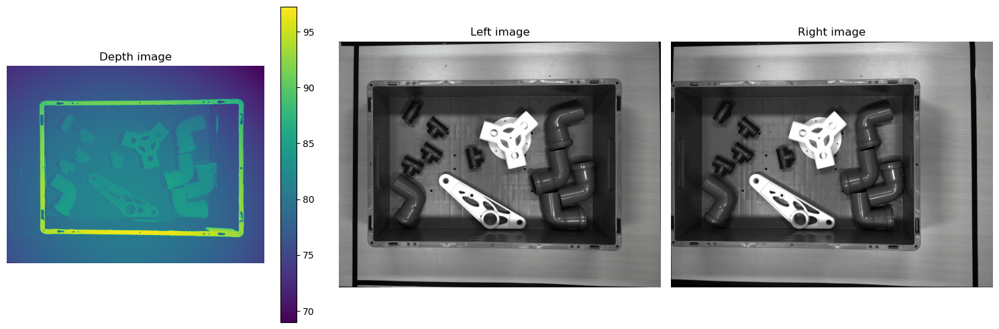

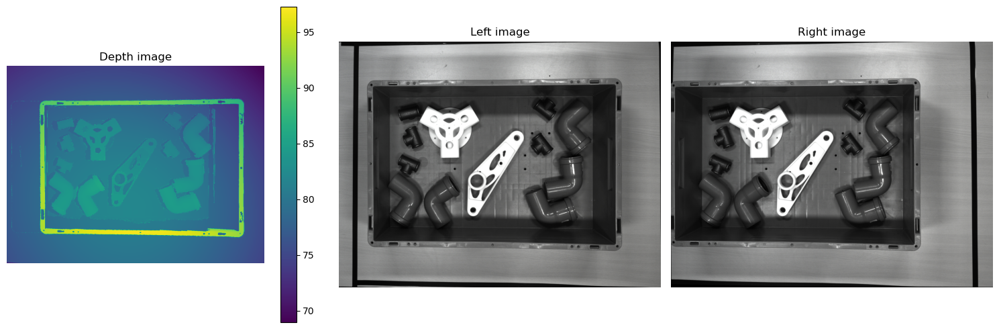

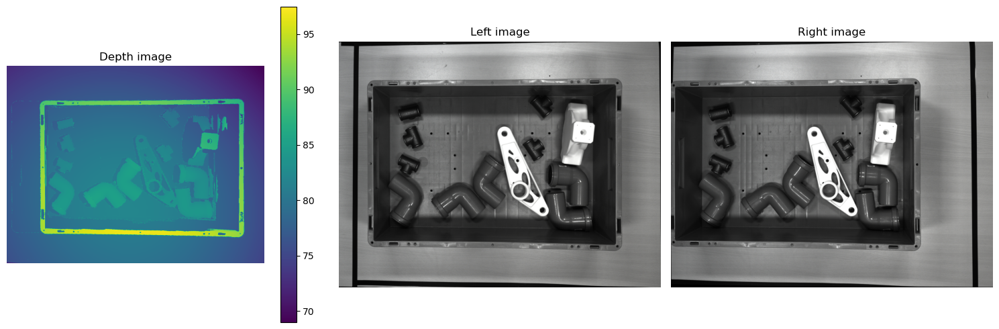

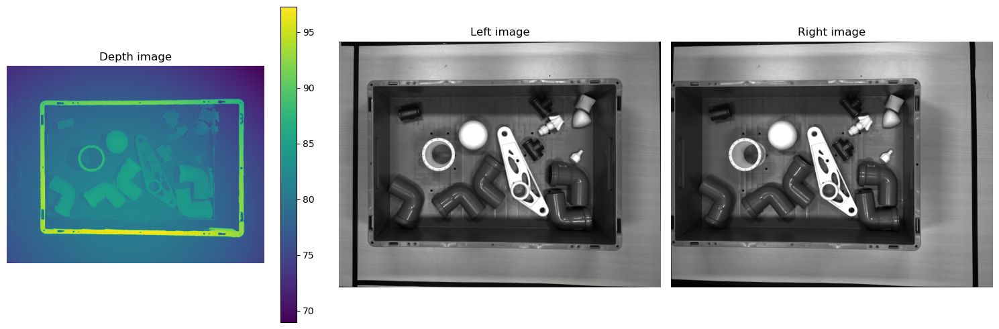

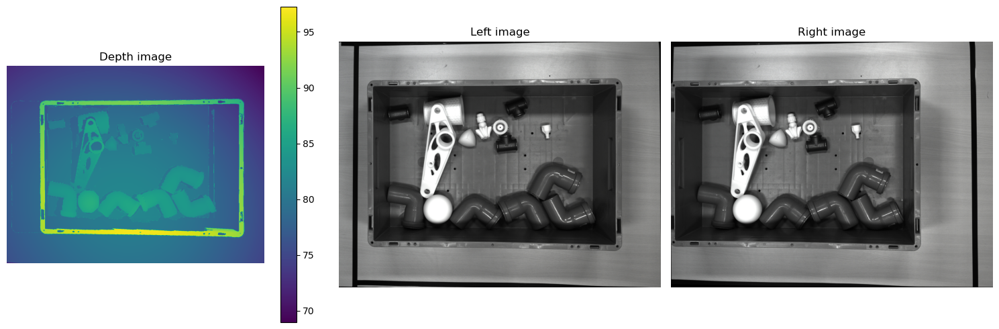

...

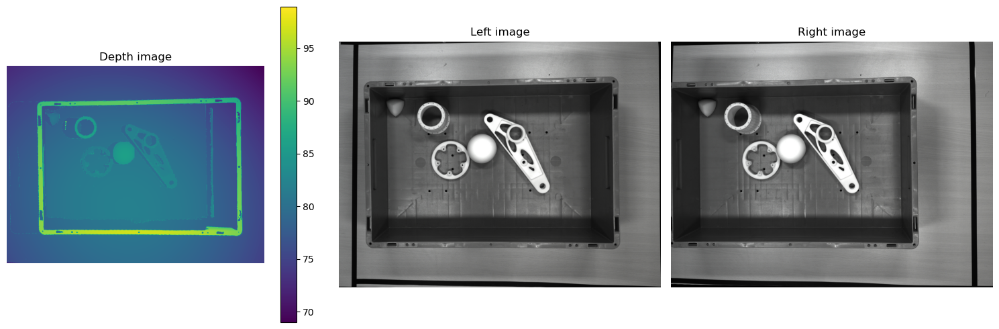

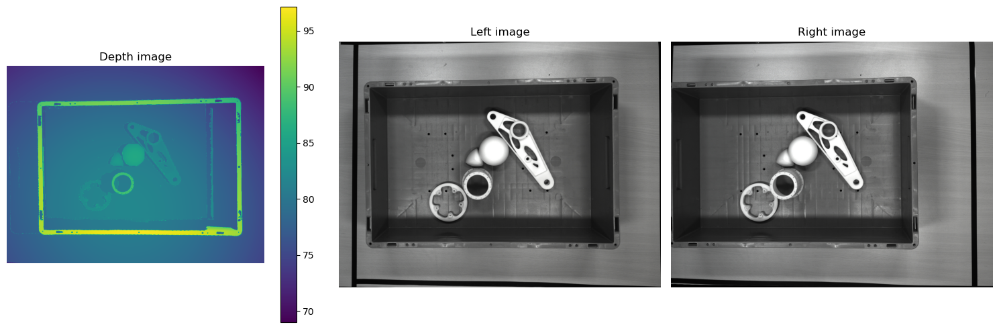

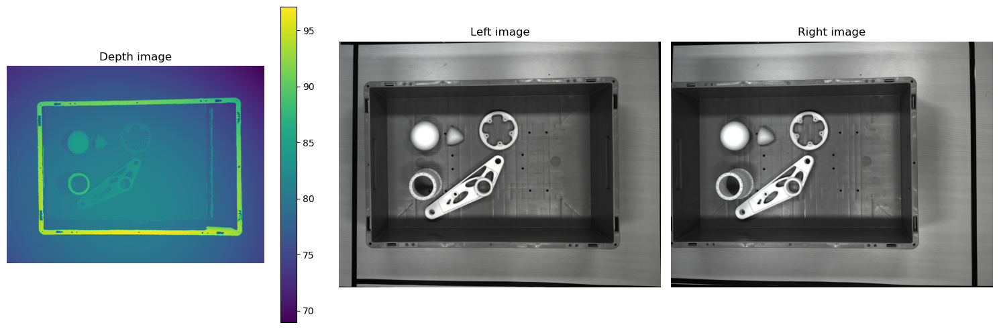

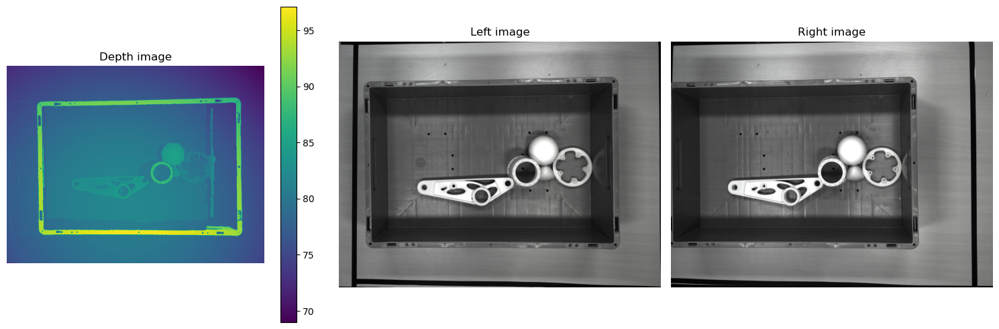

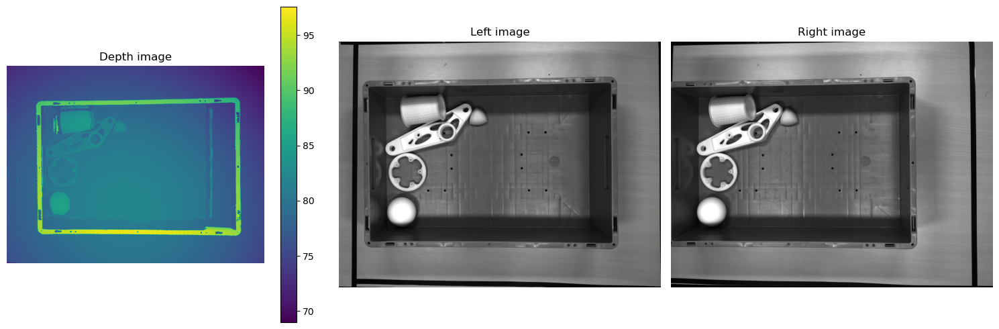

In [4]:
pfm_path           = os.path.join(BASE_DIR, 'data_2/ground_truth_pfm_rect_cor_disp_half')
image_folder_left  = os.path.join(BASE_DIR, 'data_2/multicast_rect_reso/camera1')
image_folder_right = os.path.join(BASE_DIR, 'data_2/multicast_rect_reso/camera2')

list_of_pfm_files         = sorted([pfm for pfm in os.listdir(pfm_path) if pfm.endswith('.pfm')])
list_of_image_files_left  = sorted([image for image in os.listdir(image_folder_left) if image.endswith('.png')])
list_of_image_files_right = sorted([image for image in os.listdir(image_folder_right) if image.endswith('.png')])

# print(len(list_of_pfm_files))
# print(len(list_of_image_files_left))
# print(len(list_of_image_files_right))

zipped = zip(list_of_pfm_files, list_of_image_files_left, list_of_image_files_right)

for count, (pfm, image_left, image_right) in enumerate(zipped):
    depth, _    = pfm_imread(os.path.join(pfm_path, pfm))
    image_left  = plt.imread(os.path.join(image_folder_left, image_left))
    image_right = plt.imread(os.path.join(image_folder_right, image_right))

    # fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi = 300)
    fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi = 100)

    ax[1].imshow(image_left)
    ax[1].set_title('Left image')
    ax[1].axis('off')

    ax[2].imshow(image_right)
    ax[2].set_title('Right image')
    ax[2].axis('off')

    ax[0].imshow(depth)
    ax[0].set_title('Depth image')
    cbar = plt.colorbar(ax[0].imshow(depth), ax=ax[0], orientation='vertical')
    ax[0].axis('off')

    plt.tight_layout()
    save_plot = False
    if save_plot:
        SAVE_PATH = os.path.join(VIS_DIR, f"dataset_2/corrected/vis_full_{count:03}.png")
        # plt.savefig(SAVE_PATH)
    plt.show()

    # break

# DATASET 3

In [ ]:
scan_folder: List[str]        = os.path.join(BASE_DIR, 'data_3/ground_truth_pfm_rect')
reference_pfm_file: List[str] = os.path.join(BASE_DIR, 'data_1/ground_truth_pfm_rect/ground_truth_000.pfm')
output_path: List[str]        = os.path.join(BASE_DIR, 'data_3/ground_truth_pfm_rect_cor')

if not os.path.exists(output_path):
    os.makedirs(output_path)

list_of_pfm_files = sorted([pfm for pfm in os.listdir(scan_folder) if pfm.endswith('.pfm')])

reference_pfm_data, _ = pfm_imread(reference_pfm_file)
df_reference_depth    = pd.DataFrame(reference_pfm_data)

threshold = 1100

for pfm in list_of_pfm_files:
    depth, _ = pfm_imread(os.path.join(scan_folder, pfm))
    df_depth = pd.DataFrame(depth)

    # Ensure all values are numeric and replace non-numeric with NaN, then fill NaN with 0
    df_depth = df_depth.apply(pd.to_numeric, errors='coerce').fillna(0)

    # Replace values below threshold with corresponding values from the reference DataFrame
    df_depth = df_depth.where(df_depth >= threshold, df_reference_depth)

    # replace 0 values with median value
    df_depth = df_depth.where(df_depth >= threshold, 1500)

    corrected_depth = df_depth.to_numpy()

    write_pfm(os.path.join(output_path, pfm), corrected_depth)
    # break

In [ ]:
pfm_path           = os.path.join(BASE_DIR, 'data_3/ground_truth_pfm_rect_cor')
image_folder_left  = os.path.join(BASE_DIR, 'data_3/multicast_rect_reso/camera1')
image_folder_right = os.path.join(BASE_DIR, 'data_3/multicast_rect_reso/camera2')

list_of_pfm_files         = sorted([pfm for pfm in os.listdir(pfm_path) if pfm.endswith('.pfm')])
list_of_image_files_left  = sorted([image for image in os.listdir(image_folder_left) if image.endswith('.png')])
list_of_image_files_right = sorted([image for image in os.listdir(image_folder_right) if image.endswith('.png')])

print(len(list_of_pfm_files))
print(len(list_of_image_files_left))
print(len(list_of_image_files_right))

zipped = zip(list_of_pfm_files, list_of_image_files_left, list_of_image_files_right)

for count, (pfm, image_left, image_right) in enumerate(zipped):
    depth, _    = pfm_imread(os.path.join(pfm_path, pfm))
    image_left  = plt.imread(os.path.join(image_folder_left, image_left))
    image_right = plt.imread(os.path.join(image_folder_right, image_right))


    fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi = 100)

    ax[1].imshow(image_left)
    ax[1].set_title('Left image')
    ax[1].axis('off')

    ax[2].imshow(image_right)
    ax[2].set_title('Right image')
    ax[2].axis('off')

    ax[0].imshow(depth)
    ax[0].set_title('Depth image')
    # colorbar 
    cbar = plt.colorbar(ax[0].imshow(depth), ax=ax[0], orientation='vertical')
    ax[0].axis('off')

    plt.tight_layout()
    plt.show()

    save_plot = False
    if save_plot:
        SAVE_PATH = os.path.join(VIS_DIR, f"dataset_3/corrected/vis_full_{count:03}.png")
        plt.savefig(SAVE_PATH)
    # break